In [1]:
import gzip
import os
from os.path import isfile, join
import numpy as np 
import numpy as np
import matplotlib.pyplot as plt
import os
import random
import torch
from torch import nn, optim
from torch.nn import functional as F
from torchvision import transforms as T
from torch.utils.data import DataLoader, Dataset, random_split
#
import PIL
from PIL import Image
#
from jupyterthemes import jtplot
jtplot.style()

In [2]:
PATH = 'data'
#TRAIN_PATH = 'C:/Users/selen/Tesis_implementacion/data/imagenes'
#TRAIN_MASKS_PATH = 'C:/Users/selen/Tesis_implementacion/data/mascaras'
TEST_PATH = '/lung_segmentation/test'
TRAIN_PATH = "C:/Users/selen/Tesis_implementacion/data_pruebas/imagenes"
TRAIN_MASKS_PATH = "C:/Users/selen/Tesis_implementacion/data_pruebas/mascaras"

## Red U-net

In [3]:
# creating our own Dataset
class Lung_Dataset(Dataset):
    def __init__(self, data, masks=None, img_transforms=None, mask_transforms=None):
        '''
        data - train data path
        masks - train masks path
        '''
        self.train_data = data
        self.train_masks = masks
        
        self.img_transforms = img_transforms
        self.mask_transforms = mask_transforms
        
        self.images = sorted(os.listdir(self.train_data))
        self.masks = sorted(os.listdir(self.train_masks))
        
    def __len__(self):
        if self.train_masks is not None:
            assert len(self.images)==len(self.masks), 'not the same number of images and masks'
        return len(self.images)
        
    def __getitem__(self, idx):
        image_name = os.path.join(self.train_data, self.images[idx])
        img = Image.open(image_name).convert("L")
        trans = T.ToTensor()
        if self.img_transforms is not None:
            img = self.img_transforms(img)
        else:
            img =trans(img)
        
        if self.train_masks is not None:
            mask_name = os.path.join(self.train_masks, self.masks[idx])
            mask = Image.open(mask_name)
            if self.mask_transforms is not None:
                mask = self.mask_transforms(mask)
            else:
                mask = trans(mask)
            
            mask_max = mask.max().item()
            mask /= mask_max
        else:
            return img
        
        return img, mask

In [4]:
transform_data = T.Compose([
                T.Resize([224, 224]),  #aqui hago data augmentation
                T.ToTensor()] )

In [5]:
class Conv_3_k(nn.Module):
    def __init__(self, channels_in, channels_out):
        super().__init__()
        self.conv1 = nn.Conv2d(channels_in, channels_out, kernel_size=3, stride=1, padding=1)
    def forward(self, x):
        return self.conv1(x)

In [6]:
class Double_Conv(nn.Module):
    '''
    Double convolution block for U-Net
    '''
    def __init__(self, channels_in, channels_out):
        super().__init__()
        self.double_conv = nn.Sequential(
                           Conv_3_k(channels_in, channels_out),
                           nn.BatchNorm2d(channels_out),
                           nn.ReLU(),
            
                           Conv_3_k(channels_out, channels_out),
                           nn.BatchNorm2d(channels_out),
                           nn.ReLU(),
                            )
    def forward(self, x):
        return self.double_conv(x)
    
class Down_Conv(nn.Module):
    '''
    Down convolution part
    '''
    def __init__(self, channels_in, channels_out):
        super().__init__()
        self.encoder = nn.Sequential(
                        nn.MaxPool2d(2,2),
                        Double_Conv(channels_in, channels_out)
                        )
    def forward(self, x):
        return self.encoder(x)
    
class Up_Conv(nn.Module):
    '''
    Up convolution part
    '''
    def __init__(self,channels_in, channels_out):
        super().__init__()
        self.upsample_layer = nn.Sequential(
                        nn.Upsample(scale_factor=2, mode='bicubic'),
                        nn.Conv2d(channels_in, channels_in//2, kernel_size=1, stride=1)
                        )
        self.decoder = Double_Conv(channels_in, channels_out)
    
    def forward(self, x1, x2):
        '''
        x1 - upsampled volume
        x2 - volume from down sample to concatenate
        '''
        x1 = self.upsample_layer(x1)
        x = torch.cat([x2, x1],dim=1)
        return self.decoder(x)
    
class UNET(nn.Module):
    '''
    UNET model
    '''
    def __init__(self, channels_in, channels, num_classes):
        super().__init__()
        self.first_conv = Double_Conv(channels_in, channels) #64, 224, 224
        self.down_conv1 = Down_Conv(channels, 2*channels) # 128, 112, 112
        self.down_conv2 = Down_Conv(2*channels, 4*channels) # 256, 56, 56
        self.down_conv3 = Down_Conv(4*channels, 8*channels) # 512, 28, 28
        
        self.middle_conv = Down_Conv(8*channels, 16*channels) # 1024, 14, 14 
        
        self.up_conv1 = Up_Conv(16*channels, 8*channels)
        self.up_conv2 = Up_Conv(8*channels, 4*channels)
        self.up_conv3 = Up_Conv(4*channels, 2*channels)
        self.up_conv4 = Up_Conv(2*channels, channels)
        
        self.last_conv = nn.Conv2d(channels, num_classes, kernel_size=1, stride=1)
        
    def forward(self, x):
        x1 = self.first_conv(x)
        x2 = self.down_conv1(x1)
        x3 = self.down_conv2(x2)
        x4 = self.down_conv3(x3)
        
        x5 = self.middle_conv(x4)
        
        u1 = self.up_conv1(x5, x4)
        u2 = self.up_conv2(u1, x3)
        u3 = self.up_conv3(u2, x2)
        u4 = self.up_conv4(u3, x1)
        
        return self.last_conv(u4)

In [7]:

full_dataset = Lung_Dataset(TRAIN_PATH,
                           TRAIN_MASKS_PATH, 
                           img_transforms=transform_data,
                           mask_transforms=transform_data)
BATCH_SIZE = 16
TRAIN_SIZE = int(len(full_dataset)*0.8)
VAL_SIZE = len(full_dataset) - TRAIN_SIZE


In [8]:
train_dataset, val_dataset = random_split(full_dataset, [TRAIN_SIZE, VAL_SIZE])
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True)

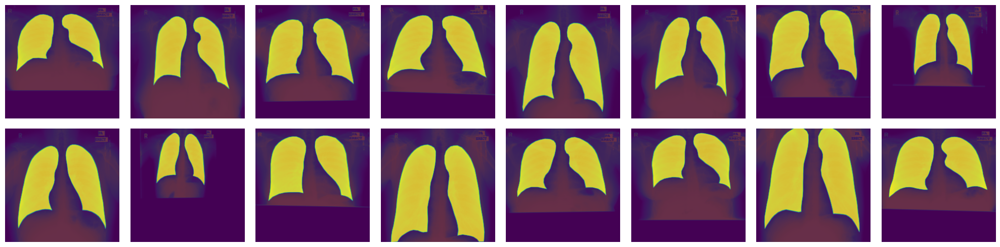

In [9]:
def plot_mini_batch(imgs, masks):
    plt.figure(figsize=(20,10))
    for i in range(BATCH_SIZE):
        plt.subplot(4, 8, i+1)
        img=imgs[i,...].permute(1,2,0).numpy()
        mask = masks[i, ...].permute(1,2,0).numpy() # tensor de pytorch(canal ancho alto)  para graficar(ancho alto canal)
        plt.imshow(img)
        plt.imshow(mask, alpha=0.8)
        
        plt.axis('Off')
    plt.tight_layout()
    plt.show()

img,masks = next(iter(train_loader))
plot_mini_batch(img, masks)

In [10]:
torch.manual_seed(42)
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

path_model = "C:/Users/selen/Tesis_implementacion/model_fold_1.pth"

torch.save(
    model.state_dict(),
    path_model)


# Modelo1 

In [11]:

def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth/model_fold_1_cluster.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

{'epoch': 12, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[ 0.2504,  0.0050,  0.2483],
          [-0.0015,  0.1865, -0.2241],
          [-0.1647, -0.1168,  0.2853]]],


        [[[ 0.3050,  0.1926, -0.1531],
          [ 0.2048, -0.0785, -0.0184],
          [-0.1911, -0.0656,  0.0695]]],


        [[[-0.1090, -0.1424,  0.0731],
          [-0.2805, -0.2367,  0.2888],
          [-0.1880, -0.2030, -0.1086]]],


        [[[ 0.2746, -0.3250, -0.2967],
          [-0.0754,  0.0642, -0.0291],
          [ 0.2618,  0.0749,  0.2792]]],


        [[[ 0.1477, -0.0932, -0.2104],
          [ 0.0904, -0.1774,  0.0217],
          [-0.2064, -0.0010, -0.1024]]],


        [[[ 0.0443, -0.1656, -0.0345],
          [-0.2938, -0.0845,  0.2534],
          [ 0.2022,  0.0858, -0.2176]]],


        [[[ 0.1335, -0.2164,  0.1173],
          [ 0.0511,  0.0075, -0.2151],
          [ 0.0786,  0.2547,  0.2086]]],


        [[[-0.2973, -0.2306, -0.0277],
          [-0.1609, -0.25

torch.Size([16, 224, 224])


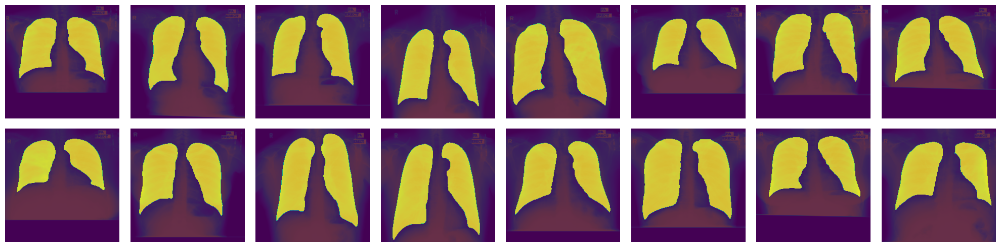

In [12]:
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

epoch: 12, mb: 2, train cost: 0.0486, val cost: 0.0572,train acc: 0.9804, val acc: 0.9799,dice: 0.9572785496711731, iou: 0.9180577993392944

# Modelo 2

In [13]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth/model_fold_2_cluster.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

{'epoch': 17, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-1.1236e-01, -3.4337e-02, -1.8183e-01],
          [ 5.9559e-02, -1.9510e-01,  2.5873e-01],
          [ 1.7340e-01, -1.3758e-01,  2.0524e-01]]],


        [[[ 2.4357e-01,  1.0555e-01, -1.6829e-01],
          [-2.5540e-01, -2.0430e-01,  2.0606e-01],
          [-2.2292e-01, -2.6895e-01,  2.0329e-02]]],


        [[[-1.9777e-01, -5.8143e-02, -1.3829e-01],
          [-1.2720e-01,  3.2929e-01, -1.9504e-01],
          [ 1.1152e-01,  6.9157e-02,  3.1401e-02]]],


        [[[ 2.4918e-01, -2.3376e-01, -3.1171e-01],
          [ 2.3877e-01, -2.4234e-01,  7.8523e-02],
          [-1.9041e-01,  1.8476e-01, -1.2862e-01]]],


        [[[-3.1669e-02,  2.7381e-01,  1.1995e-01],
          [-2.9791e-01, -2.6816e-01, -2.8765e-01],
          [ 1.8088e-02,  1.1643e-01, -1.3256e-01]]],


        [[[ 2.7442e-01,  2.1204e-02, -2.7418e-01],
          [ 2.7898e-01, -1.4808e-01,  3.0567e-01],
          [ 7.8141e-02, 

torch.Size([16, 224, 224])


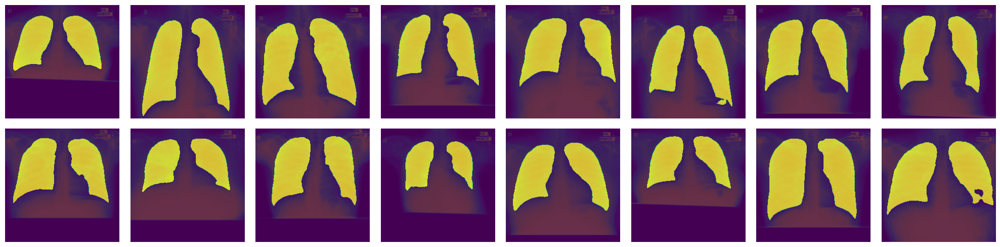

In [14]:
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

epoch: 17, mb: 10, train cost: 0.0382, val cost: 0.0550,train acc: 0.9849, val acc: 0.9800,dice: 0.9575092792510986, iou: 0.9184823036193848

# Modelo 3

In [15]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth/model_fold_3_cluster.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

{'epoch': 10, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[ 0.2556, -0.1906,  0.1151],
          [-0.1892, -0.1567, -0.1732],
          [ 0.1779,  0.1117,  0.3281]]],


        [[[ 0.2458, -0.2414,  0.1917],
          [ 0.1302, -0.2587, -0.1057],
          [ 0.1094, -0.1479,  0.2819]]],


        [[[ 0.0250, -0.2263, -0.0239],
          [-0.1720, -0.0932,  0.2692],
          [ 0.3310, -0.2139,  0.1230]]],


        [[[-0.0264, -0.2006,  0.2503],
          [-0.1782,  0.0848,  0.1592],
          [-0.0320, -0.2422,  0.2395]]],


        [[[-0.1012,  0.1297,  0.2476],
          [ 0.2844,  0.1757,  0.2418],
          [-0.2871, -0.1385, -0.3138]]],


        [[[-0.2172,  0.1208,  0.2915],
          [-0.2216, -0.0996,  0.1189],
          [ 0.3243,  0.1693,  0.0391]]],


        [[[-0.0271,  0.1618, -0.2634],
          [-0.2367,  0.1776, -0.0723],
          [ 0.2931, -0.3100, -0.1835]]],


        [[[ 0.1309,  0.0773,  0.3266],
          [ 0.2692,  0.20

torch.Size([16, 224, 224])


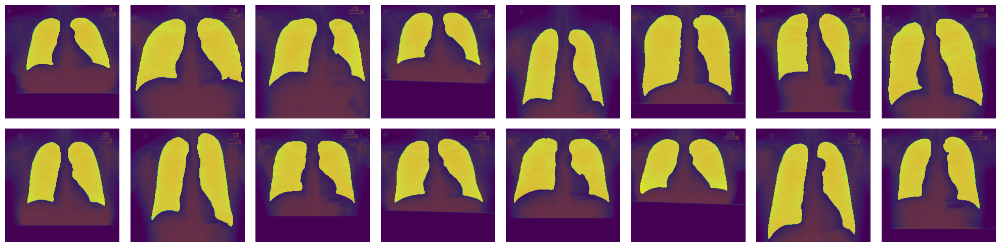

In [16]:
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

epoch: 10, mb: 36, train cost: 0.0436, val cost: 0.0564,train acc: 0.9831, val acc: 0.9789,dice: 0.9569826126098633, iou: 0.9175136089324951

# Modelo 4

In [17]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth/model_fold_4_cluster.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

{'epoch': 16, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-2.6619e-01, -1.6577e-01,  4.1698e-02],
          [-1.7308e-01, -1.2843e-01, -2.6467e-01],
          [-2.8880e-01, -2.6214e-01,  3.1229e-01]]],


        [[[ 2.6781e-01, -3.1698e-02, -1.8972e-01],
          [ 5.7309e-04, -1.8394e-01,  2.3215e-02],
          [-2.9454e-01, -2.5026e-01, -3.0198e-01]]],


        [[[ 1.0343e-01,  3.0401e-01,  3.1164e-01],
          [-1.1919e-01, -2.9309e-01, -2.2034e-01],
          [ 2.2926e-01,  2.8718e-01, -5.1244e-02]]],


        [[[ 2.2895e-01,  1.3552e-01,  2.4594e-01],
          [-4.6773e-02,  2.6572e-01, -2.2269e-01],
          [ 1.3422e-01, -2.8889e-03, -8.4646e-02]]],


        [[[-7.7995e-02,  1.6951e-01,  1.3936e-01],
          [-3.0271e-01, -1.0335e-01, -2.2665e-01],
          [ 5.6776e-02,  7.6485e-02, -1.4198e-01]]],


        [[[ 3.1022e-01,  2.3833e-02, -2.1488e-01],
          [ 7.2093e-02, -2.5035e-02, -1.7529e-01],
          [ 7.6864e-02, 

torch.Size([16, 224, 224])


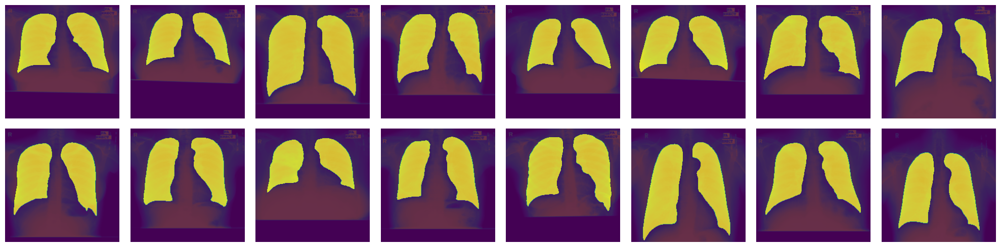

In [18]:
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

epoch: 16, mb: 16, train cost: 0.0429, val cost: 0.0566,train acc: 0.9830, val acc: 0.9791,dice: 0.9571531414985657, iou: 0.9178271889686584

# Modelo 5

In [19]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth/model_fold_5_cluster.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)


{'epoch': 14, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-0.2976, -0.1963, -0.2897],
          [-0.2654,  0.1223,  0.1546],
          [-0.1113,  0.2942,  0.0194]]],


        [[[ 0.1589,  0.2275,  0.0602],
          [-0.1406,  0.3057,  0.0308],
          [-0.1261, -0.1577, -0.2026]]],


        [[[ 0.1808, -0.2125,  0.3095],
          [ 0.2156, -0.0881,  0.2882],
          [-0.2335,  0.1122,  0.1233]]],


        [[[ 0.0960, -0.2959,  0.1908],
          [-0.0234,  0.1413,  0.0864],
          [ 0.3054,  0.0949,  0.1648]]],


        [[[ 0.1321,  0.2199, -0.1115],
          [ 0.2759,  0.1561,  0.2047],
          [ 0.2565,  0.2825,  0.0031]]],


        [[[-0.0321, -0.2704,  0.1826],
          [-0.1366,  0.3194, -0.0147],
          [-0.2406, -0.0149, -0.2104]]],


        [[[-0.3079, -0.3306,  0.1521],
          [ 0.2014, -0.0320, -0.2783],
          [ 0.0880,  0.2269,  0.2846]]],


        [[[-0.0802,  0.2632, -0.0652],
          [-0.0435, -0.23

torch.Size([16, 224, 224])


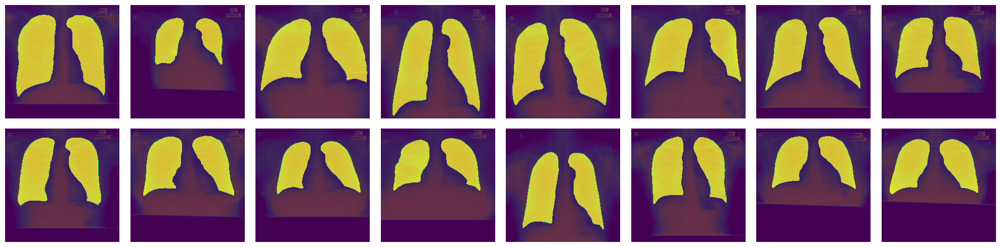

In [20]:
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

epoch: 14, mb: 14, train cost: 0.0383, val cost: 0.0556,train acc: 0.9849, val acc: 0.9797,dice: 0.9573875069618225, iou: 0.9182582497596741

# Análisis de modelos

##########
Con 25 épocas
#############

Modelo 1: epoch: 12, mb: 2, train cost: 0.0486, val cost: 0.0572,train acc: 0.9804, val acc: 0.9799,dice: 0.9572785496711731, iou: 0.9180577993392944
Modelo 2: epoch: 17, mb: 10, train cost: 0.0382, val cost: 0.0550,train acc: 0.9849, val acc: 0.9800,dice: 0.9575092792510986, iou: 0.9184823036193848
Modelo 3: epoch: 10, mb: 36, train cost: 0.0436, val cost: 0.0564,train acc: 0.9831, val acc: 0.9789,dice: 0.9569826126098633, iou: 0.9175136089324951
Modelo 4: epoch: 16, mb: 16, train cost: 0.0429, val cost: 0.0566,train acc: 0.9830, val acc: 0.9791,dice: 0.9571531414985657, iou: 0.9178271889686584
Modelo 5: epoch: 14, mb: 14, train cost: 0.0383, val cost: 0.0556,train acc: 0.9849, val acc: 0.9797,dice: 0.9573875069618225, iou: 0.9182582497596741


################################################################################################
Con 45 épocas
############################################################################################

Modelo 1: epoch: 16, mb: 32, train cost: 0.0476, val cost: 0.0524,train acc: 0.9823, val acc: 0.9809,dice: 0.9591774940490723, iou: 0.9215572476387024
Modelo 2: epoch: 27, mb: 16, train cost: 0.0418, val cost: 0.0490,train acc: 0.9832, val acc: 0.9815,dice: 0.9611852169036865, iou: 0.9252710938453674
Modelo 3: epoch: 7, mb: 32, train cost: 0.0459, val cost: 0.0492,train acc: 0.9823, val acc: 0.9819,dice: 0.9623633623123169, iou: 0.9274569749832153
Modelo 4: epoch: 10, mb: 32, train cost: 0.0415, val cost: 0.0511,train acc: 0.9836, val acc: 0.9812,dice: 0.9606032371520996, iou: 0.9241930842399597
Modelo 5: epoch: 17, mb: 16, train cost: 0.0409, val cost: 0.0518,train acc: 0.9836, val acc: 0.9805,dice: 0.9593231081962585, iou: 0.9218260645866394

# Modelo 1 - 45 epoch 

{'epoch': 16, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-0.3028,  0.1914, -0.3703],
          [-0.1203, -0.3744,  0.0309],
          [-0.0441,  0.1539,  0.1427]]],


        [[[ 0.0728, -0.3066, -0.1437],
          [-0.1606, -0.2361, -0.3005],
          [-0.1099,  0.2912,  0.1718]]],


        [[[ 0.2042,  0.2564, -0.0864],
          [ 0.1821, -0.1125, -0.0581],
          [ 0.0443,  0.1536,  0.3071]]],


        [[[-0.0550, -0.1655, -0.3173],
          [-0.2788,  0.0532, -0.2171],
          [-0.1981,  0.2375,  0.0005]]],


        [[[ 0.1352, -0.1302,  0.2077],
          [-0.2103, -0.2717, -0.1112],
          [-0.0851, -0.1975,  0.2965]]],


        [[[ 0.1120,  0.2648,  0.0140],
          [ 0.1606,  0.1548,  0.2779],
          [-0.0226,  0.2201,  0.1672]]],


        [[[ 0.0265, -0.1357, -0.0816],
          [ 0.1585,  0.0737, -0.2665],
          [-0.1409, -0.1884,  0.2678]]],


        [[[ 0.2537,  0.0903,  0.0319],
          [-0.1900,  0.28

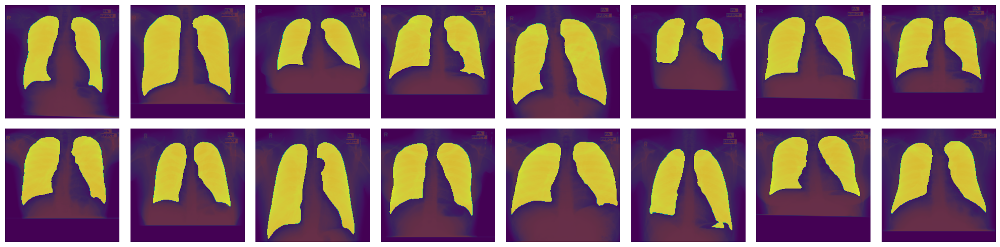

In [21]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_1_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

# Modelo 2 - 45 epoch 

{'epoch': 27, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-0.2453, -0.1176, -0.1898],
          [ 0.2889, -0.2288, -0.0804],
          [ 0.1393, -0.0641, -0.3025]]],


        [[[ 0.0541,  0.2478, -0.2008],
          [-0.1452,  0.2019,  0.0072],
          [ 0.0570,  0.2980, -0.0693]]],


        [[[ 0.2502,  0.0957,  0.0318],
          [ 0.2598, -0.1933,  0.2759],
          [ 0.2956, -0.2733, -0.1102]]],


        [[[ 0.0501,  0.0764,  0.3095],
          [-0.1061, -0.2178,  0.1541],
          [ 0.1291,  0.1071, -0.2961]]],


        [[[ 0.1844, -0.0652, -0.0819],
          [ 0.0558,  0.1369,  0.1421],
          [ 0.2871, -0.1663, -0.2158]]],


        [[[-0.2034, -0.2173, -0.0764],
          [-0.0758,  0.0477,  0.0059],
          [-0.1618,  0.1236,  0.3094]]],


        [[[-0.2195, -0.1813, -0.1487],
          [ 0.1877, -0.1041, -0.0018],
          [-0.2004,  0.0348,  0.0263]]],


        [[[-0.1246, -0.0080, -0.0856],
          [ 0.0389, -0.19

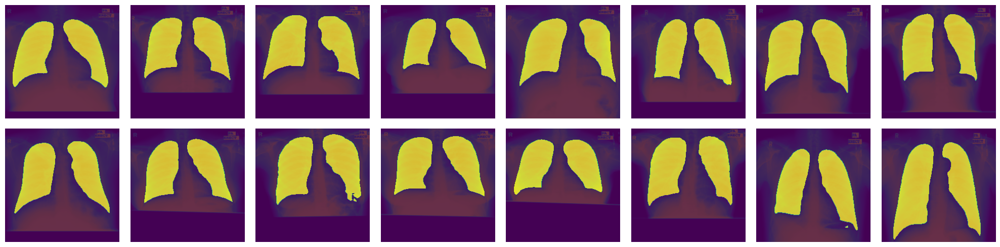

In [22]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_2_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

# Modelo 3 - 45 epoch 

{'epoch': 7, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-2.4195e-01,  2.3004e-01,  3.7419e-02],
          [-2.2909e-01,  2.4923e-01, -2.8409e-01],
          [ 2.0666e-01,  9.3020e-02, -3.0392e-01]]],


        [[[ 1.4890e-01,  2.4704e-01, -1.2442e-01],
          [ 1.1542e-01,  9.4917e-02,  2.1787e-01],
          [-2.6648e-01, -3.0585e-01,  2.5805e-01]]],


        [[[ 2.6650e-01,  5.0707e-02, -9.7269e-02],
          [-2.0601e-01,  1.0083e-01, -8.8392e-02],
          [ 2.7815e-01, -1.6833e-01, -1.0524e-01]]],


        [[[ 2.6129e-01, -3.0275e-01, -2.4861e-01],
          [-2.6389e-01,  1.6067e-01, -6.0852e-02],
          [ 2.4401e-01,  2.5390e-01, -1.7904e-02]]],


        [[[ 8.8718e-02,  2.3170e-01, -5.1476e-03],
          [-3.0708e-01, -2.9821e-01,  5.1399e-02],
          [ 5.1721e-02, -1.9955e-01, -3.2151e-01]]],


        [[[ 7.7280e-02,  6.3973e-02, -2.4102e-01],
          [ 1.0491e-01,  2.9220e-01,  1.6984e-01],
          [-2.2177e-01, -

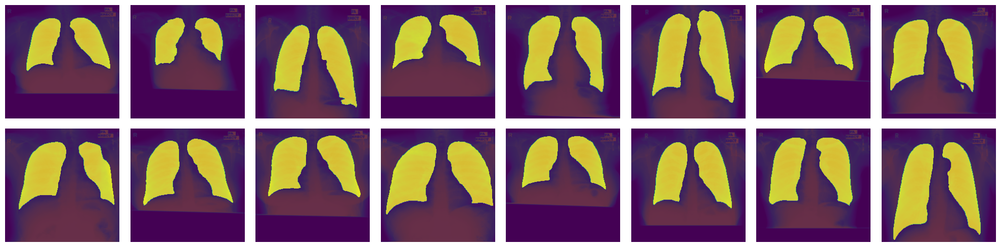

In [23]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_3_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

# Modelo 3 - 45 epoch 

{'epoch': 7, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-2.4195e-01,  2.3004e-01,  3.7419e-02],
          [-2.2909e-01,  2.4923e-01, -2.8409e-01],
          [ 2.0666e-01,  9.3020e-02, -3.0392e-01]]],


        [[[ 1.4890e-01,  2.4704e-01, -1.2442e-01],
          [ 1.1542e-01,  9.4917e-02,  2.1787e-01],
          [-2.6648e-01, -3.0585e-01,  2.5805e-01]]],


        [[[ 2.6650e-01,  5.0707e-02, -9.7269e-02],
          [-2.0601e-01,  1.0083e-01, -8.8392e-02],
          [ 2.7815e-01, -1.6833e-01, -1.0524e-01]]],


        [[[ 2.6129e-01, -3.0275e-01, -2.4861e-01],
          [-2.6389e-01,  1.6067e-01, -6.0852e-02],
          [ 2.4401e-01,  2.5390e-01, -1.7904e-02]]],


        [[[ 8.8718e-02,  2.3170e-01, -5.1476e-03],
          [-3.0708e-01, -2.9821e-01,  5.1399e-02],
          [ 5.1721e-02, -1.9955e-01, -3.2151e-01]]],


        [[[ 7.7280e-02,  6.3973e-02, -2.4102e-01],
          [ 1.0491e-01,  2.9220e-01,  1.6984e-01],
          [-2.2177e-01, -

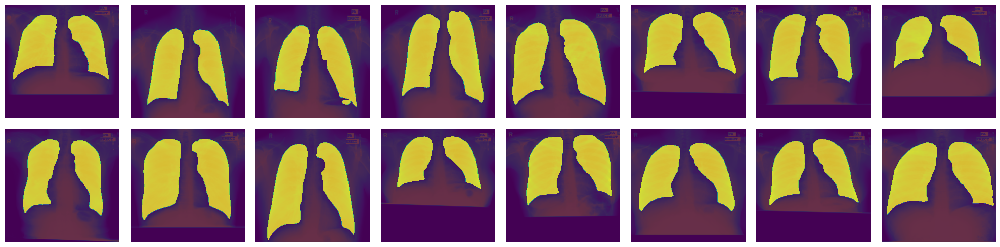

In [24]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_3_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

# Modelo 4 - 45 epoch 

{'epoch': 10, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-0.1206, -0.1313,  0.2563],
          [-0.1672, -0.2693,  0.0216],
          [-0.1047,  0.1128,  0.3275]]],


        [[[-0.2797, -0.0533, -0.3259],
          [ 0.0555, -0.2991, -0.2321],
          [-0.1335, -0.2327,  0.3063]]],


        [[[ 0.1384, -0.2492,  0.0065],
          [-0.1393, -0.1947, -0.0439],
          [ 0.1498, -0.2975, -0.2313]]],


        [[[ 0.0194,  0.2050,  0.1836],
          [ 0.0516,  0.1691, -0.1385],
          [-0.0547,  0.3351, -0.2516]]],


        [[[-0.0437,  0.3162,  0.2418],
          [ 0.1363, -0.0318, -0.2337],
          [ 0.1622, -0.0602, -0.2385]]],


        [[[ 0.1609, -0.1155, -0.2766],
          [ 0.1957, -0.2746, -0.0041],
          [-0.3271, -0.2639, -0.1225]]],


        [[[ 0.2718,  0.0940, -0.0175],
          [ 0.0256, -0.2244,  0.3271],
          [ 0.2012, -0.0513,  0.2717]]],


        [[[-0.2367, -0.2060,  0.2653],
          [-0.1948,  0.22

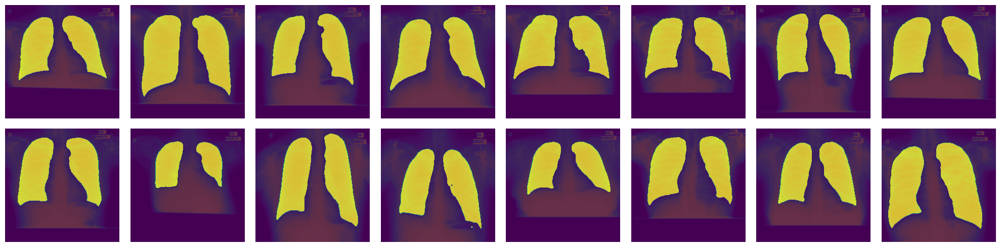

In [25]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_4_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

# Modelo 5 - 45 epoch 

{'epoch': 17, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[ 3.0448e-01, -8.0429e-02, -2.8686e-01],
          [-1.5163e-01, -2.0064e-01,  1.1139e-01],
          [ 1.6713e-03,  2.6557e-01,  1.4664e-01]]],


        [[[ 1.4065e-01, -9.4118e-02,  5.6530e-02],
          [-2.1504e-01,  3.0832e-01,  2.3611e-01],
          [ 2.2452e-01,  7.6497e-02,  2.9308e-01]]],


        [[[-2.1425e-01, -5.2776e-02, -1.5264e-01],
          [-2.2937e-01,  1.8702e-01,  4.4504e-02],
          [-2.1054e-01,  1.9521e-01, -2.3654e-01]]],


        [[[-8.7917e-02,  2.5826e-01, -1.7184e-01],
          [ 2.6066e-01,  1.1723e-01, -1.3238e-01],
          [-3.0017e-01, -3.0226e-01,  9.4354e-02]]],


        [[[-1.3406e-01,  6.7991e-02, -1.8398e-02],
          [-5.6914e-02,  1.5710e-01, -1.6320e-01],
          [ 2.9295e-01,  9.8843e-02, -3.0822e-01]]],


        [[[-2.7787e-01,  1.5101e-01, -2.1809e-01],
          [-4.0201e-02, -2.7480e-01, -3.8190e-02],
          [-2.4225e-01, 

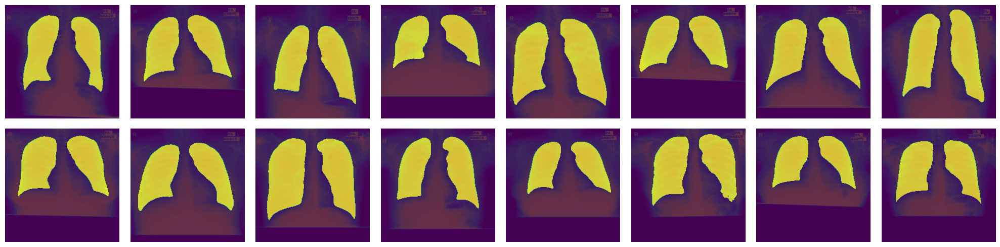

In [26]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch

# Create the model and optimizer instances
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

# Load the saved model
filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_5_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

# Move the model to the appropriate device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1)) 

# Masking images

{'epoch': 27, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-0.2453, -0.1176, -0.1898],
          [ 0.2889, -0.2288, -0.0804],
          [ 0.1393, -0.0641, -0.3025]]],


        [[[ 0.0541,  0.2478, -0.2008],
          [-0.1452,  0.2019,  0.0072],
          [ 0.0570,  0.2980, -0.0693]]],


        [[[ 0.2502,  0.0957,  0.0318],
          [ 0.2598, -0.1933,  0.2759],
          [ 0.2956, -0.2733, -0.1102]]],


        [[[ 0.0501,  0.0764,  0.3095],
          [-0.1061, -0.2178,  0.1541],
          [ 0.1291,  0.1071, -0.2961]]],


        [[[ 0.1844, -0.0652, -0.0819],
          [ 0.0558,  0.1369,  0.1421],
          [ 0.2871, -0.1663, -0.2158]]],


        [[[-0.2034, -0.2173, -0.0764],
          [-0.0758,  0.0477,  0.0059],
          [-0.1618,  0.1236,  0.3094]]],


        [[[-0.2195, -0.1813, -0.1487],
          [ 0.1877, -0.1041, -0.0018],
          [-0.2004,  0.0348,  0.0263]]],


        [[[-0.1246, -0.0080, -0.0856],
          [ 0.0389, -0.19

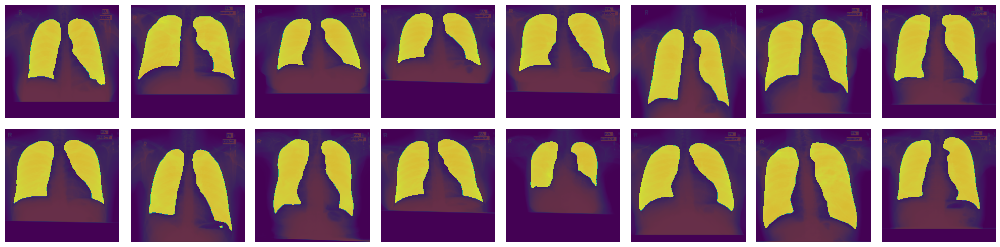

In [27]:
def load_checkpoint(model, optimizer, filename):
    checkpoint = torch.load(filename,map_location=torch.device('cpu'))
    print(checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    return model, optimizer, epoch


model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)


filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_2_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
imgs_val, masks_val = next(iter(val_loader))
imgs_val = imgs_val.to(device='cpu', dtype=torch.float32)
model = model.to('cpu')
with torch.no_grad():
    scores = model(imgs_val)
    preds = torch.argmax(scores, dim=1).float()

imgs_val = imgs_val.cpu()
preds = preds.cpu()
print(preds.shape)
plot_mini_batch(imgs_val, preds.unsqueeze(1))

In [28]:
TEST_PATH = "C:/Users/selen/Tesis_implementacion/Imagenes_etapa2_sin_mascara/images_no_label"
BATCH_SIZE= 32
test_set = Car_Dataset(TEST_PATH, img_transforms=transform_data)
test_loader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=True)

{'epoch': 27, 'model_state_dict': OrderedDict([('first_conv.double_conv.0.conv1.weight', tensor([[[[-0.2453, -0.1176, -0.1898],
          [ 0.2889, -0.2288, -0.0804],
          [ 0.1393, -0.0641, -0.3025]]],


        [[[ 0.0541,  0.2478, -0.2008],
          [-0.1452,  0.2019,  0.0072],
          [ 0.0570,  0.2980, -0.0693]]],


        [[[ 0.2502,  0.0957,  0.0318],
          [ 0.2598, -0.1933,  0.2759],
          [ 0.2956, -0.2733, -0.1102]]],


        [[[ 0.0501,  0.0764,  0.3095],
          [-0.1061, -0.2178,  0.1541],
          [ 0.1291,  0.1071, -0.2961]]],


        [[[ 0.1844, -0.0652, -0.0819],
          [ 0.0558,  0.1369,  0.1421],
          [ 0.2871, -0.1663, -0.2158]]],


        [[[-0.2034, -0.2173, -0.0764],
          [-0.0758,  0.0477,  0.0059],
          [-0.1618,  0.1236,  0.3094]]],


        [[[-0.2195, -0.1813, -0.1487],
          [ 0.1877, -0.1041, -0.0018],
          [-0.2004,  0.0348,  0.0263]]],


        [[[-0.1246, -0.0080, -0.0856],
          [ 0.0389, -0.19

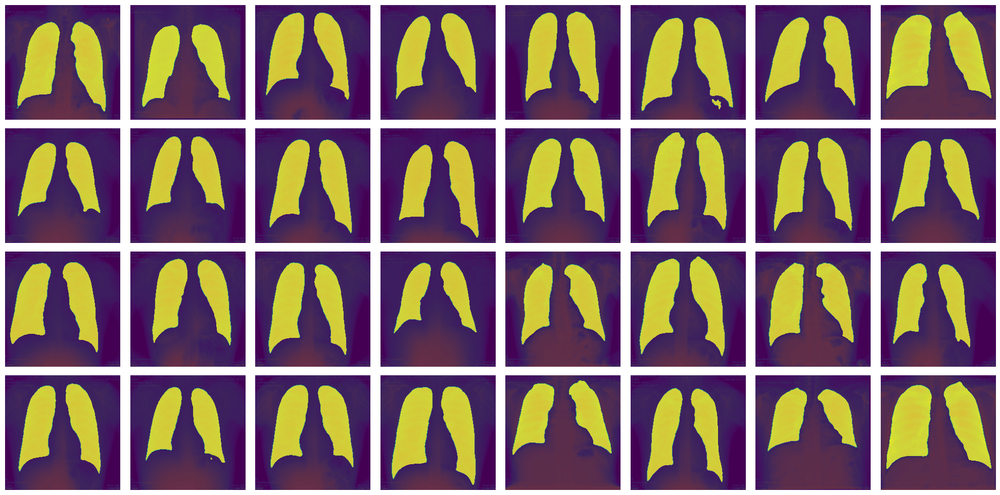

In [29]:
model = UNET(1, 64, 2)
optimiser_unet = torch.optim.SGD(model.parameters(),
                                 lr=0.01, momentum=0.95,
                                 weight_decay=1e-4)

filename = 'C:/Users/selen/Tesis_implementacion/archivos_pth_epoch_45/model_fold_2_45ep.pth'
model, optimiser_unet, epoch = load_checkpoint(model, optimiser_unet, filename)

imgs_test = next(iter(test_loader))
imgs_test = imgs_test.to(device, dtype=torch.float32)
model = model.to(device)
with torch.no_grad():
    scores = model(imgs_test)
    preds = torch.argmax(scores, dim=1).float()

imgs_test = imgs_test.cpu()
preds = preds.cpu()
#print(preds.shape)
plot_mini_batch(imgs_test, preds.unsqueeze(1))

In [30]:
TEST_PATH = "C:/Users/selen/Tesis_implementacion/Imagenes_etapa2_sin_mascara/images_no_label"
BATCH_SIZE= 1
test_set = Car_Dataset(TEST_PATH, img_transforms=transform_data)
test_loader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=True)

torch.Size([1, 224, 224])


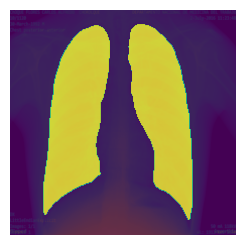

In [31]:

import numpy as np
import torch
from PIL import Image

output_folder = "C:Users/selen/Tesis_implementacion/Imagenes_etapa2_sin_mascara/images_label_masks"
imgs_test = next(iter(test_loader))
imgs_test = imgs_test.to(device, dtype=torch.float32)
model = model.to(device)

with torch.no_grad():
    scores = model(imgs_test)
    preds = torch.argmax(scores, dim=1).float()

imgs_test = imgs_test.cpu()
preds = preds.cpu()
mask = preds.unsqueeze(1)
mask_np = mask.squeeze().cpu().numpy()
imgs_test_np = imgs_test.squeeze().cpu().numpy()



mask_pil = Image.fromarray((mask_np * 255).astype(np.uint8))


resized_mask_pil = mask_pil.resize((3584, 4352), Image.LANCZOS)


resized_mask_np = np.array(resized_mask_pil) / 255

segmented_lungs =  imgs_test_np - imgs_test_np * (1 - mask_np) 
final_image_pil = Image.fromarray((segmented_lungs * 255).astype(np.uint8))
final_image_pil.save('final_image.jpg')

print(preds.shape)
plot_mini_batch(imgs_test, preds.unsqueeze(1))

In [39]:
import os
import torch
import torchvision.transforms as transforms
from PIL import Image, ImageOps
import numpy as np
import cv2

def smooth_edges(image, kernel_size=5, blur_type='gaussian'):
    if blur_type == 'gaussian':
        smoothed_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
    elif blur_type == 'median':
        smoothed_image = cv2.medianBlur(image, kernel_size)
    else:
        raise ValueError("Invalid blur_type. Choose 'gaussian' or 'median'.")
    return smoothed_image


image_folder = "C:/Users/selen/Tesis_implementacion/ETAPA_MACHINE_LEARNING"

resize = transforms.Resize((256, 256))
to_tensor = transforms.ToTensor()

for img_file in os.listdir(image_folder):
    img_path = os.path.join(image_folder, img_file)

    img = Image.open(img_path).convert("L") 
    img_resized = resize(img)
    img_tensor = to_tensor(img_resized) 
    original_height, original_width = img.size
   
    img_tensor = img_tensor.unsqueeze(0)

    with torch.no_grad():
        output = model(img_tensor)
        preds = torch.argmax(scores, dim=1).float()
    
    preds = preds.cpu()
    mask = preds.unsqueeze(1)
    mask_np = mask.squeeze().cpu().numpy()
    
    mask_pil = Image.fromarray((mask_np * 255).astype(np.uint8))

   
    mask_pil.save(f'{img_name}_mask_256x256.jpg')
    
    mask_pil = Image.fromarray((mask_np * 255).astype(np.uint8))
    resized_mask_pil = mask_pil.resize((original_height, original_width), Image.BICUBIC)
    resized_mask_np = np.array(resized_mask_pil) / 255

    
    smoothed_mask_np = smooth_edges(resized_mask_np, kernel_size=5, blur_type='gaussian')
    
    mask_pil_2 = Image.fromarray((smoothed_mask_np*255).astype(np.uint8))

    
    mask_pil_2.save(f'{img_name}_mask_original_shape.jpg')

    final_image_pil.save(f'{img_name}_mask_original_shape.jpg')
   
    imgs_test_np = np.array(img)
   
    segmented_lungs = imgs_test_np * smoothed_mask_np
    
    img_name = os.path.splitext(img_file)[0] 
    print("Processed image:", img_name)

    final_image_pil = Image.fromarray((segmented_lungs * 255).astype(np.uint8))
    final_image_pil.save(f'{img_name}_lungs_original_shape.jpg')

Processed image: 00_Normal_1_p
Processed image: 00_Normal_2_P
Processed image: 11_rr_1
Processed image: 11_rr_equalized_image


In [36]:
import cv2

original_image = cv2.imread('C:/Users/selen/Tesis_implementacion/Imagenes_etapa2_sin_mascara/matlab/img-00001-00001.jpg', cv2.IMREAD_GRAYSCALE)
mask = cv2.imread('C:/Users/selen/Tesis_implementacion/Imagenes_etapa2_sin_mascara/matlab/img-00001-00001_mask_256_256.jpg', cv2.IMREAD_GRAYSCALE)

original_height, original_width = original_image.shape

resized_mask = cv2.resize(mask, (original_width, original_height), interpolation=cv2.INTER_LANCZOS4)
segmented_lungs = resized_mask*original_image
cv2.imwrite('segmented_lungs3.jpg', segmented_lungs)

True